# How to Train YOLOv5 on Custom Objects

This tutorial is based on the [YOLOv5 repository](https://github.com/ultralytics/yolov5) by [Ultralytics](https://www.ultralytics.com/). This notebook shows training on **your own custom objects**. Many thanks to Ultralytics for putting this repository together - we hope that in combination with clean data management tools at Roboflow, this technologoy will become easily accessible to any developer wishing to use computer vision in their projects.




#Install Dependencies

_(Remember to choose GPU in Runtime if not already selected. Runtime --> Change Runtime Type --> Hardware accelerator --> GPU)_

In [1]:
# clone YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
!git reset --hard 8ebf569d14aca4f0e5b1f730501ac73644d71ae0

Cloning into 'yolov5'...
remote: Enumerating objects: 13162, done.
remote: Counting objects: 100% (43/43), done.
remote: Compressing objects: 100% (30/30), done.
remote: Total 13162 (delta 23), reused 28 (delta 13), pack-reused 13119
Receiving objects: 100% (13162/13162), 12.54 MiB | 19.05 MiB/s, done.
Resolving deltas: 100% (9034/9034), done.
/content/yolov5
HEAD is now at 8ebf569 Fix bias warmup LR init (#8356)


In [2]:
# install dependencies as necessary
!pip install -qr requirements.txt  # install dependencies (ignore errors)
import torch

from IPython.display import Image, clear_output  # to display images
from utils.downloads import gdrive_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

     |████████████████████████████████| 596 kB 7.3 MB/s 
Setup complete. Using torch 1.12.0+cu113 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


In [3]:
%cd /content/yolov5

%mkdir Public-Parking-Dataset
%cd ./Public-Parking-Dataset
!curl -L "https://www.dropbox.com/s/o1ghy5agbx7hg77/Public-Parking-Dataset.zip?dl=0" > dataset.zip; unzip dataset.zip; rm dataset.zip

datasetFolder = "/content/yolov5/Public-Parking-Dataset"

%cd /content/yolov5

/content/yolov5
/content/yolov5/Public-Parking-Dataset
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   151    0   151    0     0    391      0 --:--:-- --:--:-- --:--:--   390
100   340  100   340    0     0    390      0 --:--:-- --:--:-- --:--:--   390
100   534    0   534    0     0    475      0 --:--:--  0:00:01 --:--:--     0
100 30.5M  100 30.5M    0     0  13.7M      0  0:00:02  0:00:02 --:--:-- 47.0M
Archive:  dataset.zip
  inflating: data.yaml               
  inflating: __MACOSX/._data.yaml    
  inflating: README.roboflow.txt     
  inflating: __MACOSX/._README.roboflow.txt  
   creating: test/
  inflating: __MACOSX/._test         
   creating: test/images/
  inflating: __MACOSX/test/._images  
   creating: test/labels/
  inflating: __MACOSX/test/._labels  
  inflating: test/images/DJI_0286_MP4-10_jpg.rf.dvrHFd9yvQdTzwTld47D.jpg  
  inflating: __MACOSX/test/im

In [4]:
# this is the YAML file
%cat "{datasetFolder}/data.yaml"

train: /content/yolov5/Public-Parking-Dataset/train/images
val: /content/yolov5/Public-Parking-Dataset/valid/images

nc: 2
names: ['Car', 'Empty']

# Define Model Configuration and Architecture

We will write a yaml script that defines the parameters for our model like the number of classes, anchors, and each layer.

You do not need to edit these cells, but you may.

In [5]:
# define number of classes based on YAML
import yaml
with open(datasetFolder + "/data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [6]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [7]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

# Train Custom YOLOv5 Detector

### Next, we'll fire off training!


Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** set the path to our yaml file
- **cfg:** specify our model configuration
- **weights:** specify a custom path to weights. (Note: you can download weights from the Ultralytics Google Drive [folder](https://drive.google.com/open?id=1Drs_Aiu7xx6S-ix95f9kNsA6ueKRpN2J))
- **name:** result names
- **nosave:** only save the final checkpoint
- **cache:** cache images for faster training

In [8]:
# train yolov5s on custom data for 100 epochs
# time its performance
%%time
%cd /content/yolov5
!python train.py --img 416 --batch 16 --epochs 200 --data {datasetFolder}/data.yaml --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache


/content/yolov5
train: weights=, cfg=./models/custom_yolov5s.yaml, data=/content/yolov5/Public-Parking-Dataset/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=200, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5s_results, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 60 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-265-g8ebf569 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_b

# Evaluate Custom YOLOv5 Detector Performance

Training losses and performance metrics are saved to Tensorboard and also to a logfile defined above with the **--name** flag when we train. In our case, we named this `yolov5s_results`. (If given no name, it defaults to `results.txt`.) The results file is plotted as a png after training completes.

Note from Glenn: Partially completed `results.txt` files can be plotted with `from utils.utils import plot_results; plot_results()`.

In [9]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
# use %load_ext tensorboard when loading for the first time
%reload_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

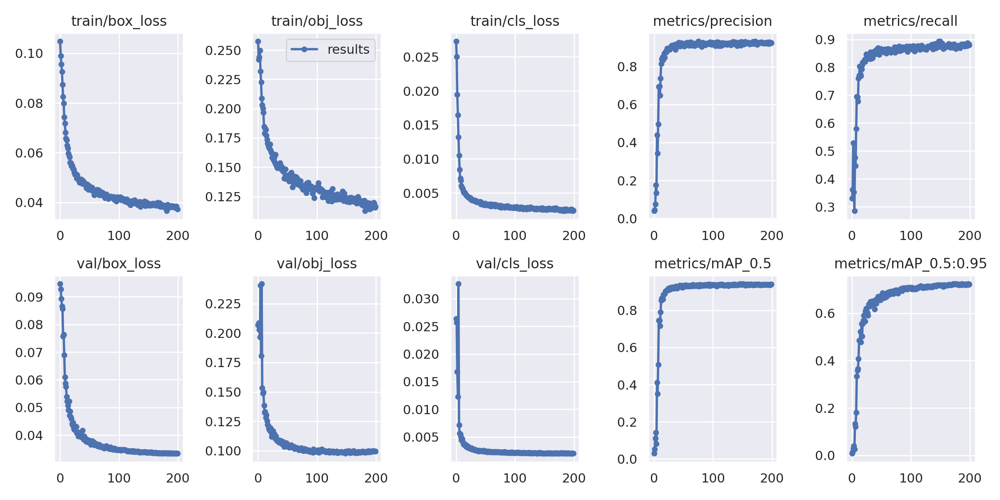

In [10]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='/content/yolov5/runs/train/yolov5s_results/results.png', width=1000)  # view results.png

### Curious? Visualize Our Training Data with Labels

After training starts, view `train*.jpg` images to see training images, labels and augmentation effects.

Note a mosaic dataloader is used for training (shown below), a new dataloading concept developed by Glenn Jocher and first featured in [YOLOv4](https://arxiv.org/abs/2004.10934).

GROUND TRUTH AUGMENTED TRAINING DATA:


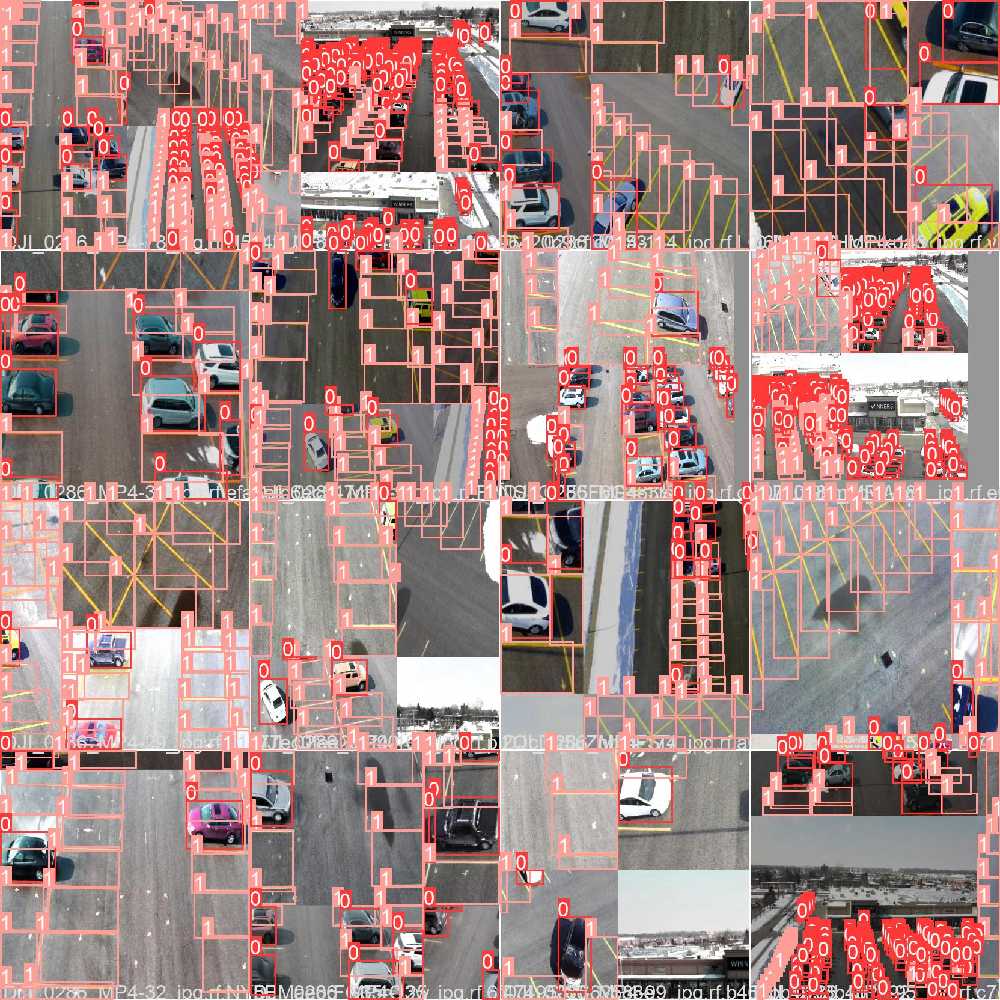

In [11]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results/train_batch0.jpg', width=900)

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [12]:
# trained weights are saved by default in our weights folder
%ls runs/

train/


In [13]:
%ls runs/train/yolov5s_results/weights

best.pt  last.pt


In [14]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
# MAKE SURE TO CHNAGE SOURCE IMAGES TO CORRECT FOLDER
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source {datasetFolder}/test/images

/content/yolov5
detect: weights=['runs/train/yolov5s_results/weights/best.pt'], source=/content/yolov5/Public-Parking-Dataset/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-265-g8ebf569 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
custom_YOLOv5s summary: 232 layers, 7249215 parameters, 0 gradients, 16.7 GFLOPs
image 1/34 /content/yolov5/Public-Parking-Dataset/test/images/DJI_0286_MP4-10_jpg.rf.dvrHFd9yvQdTzwTld47D.jpg: 416x416 4 Cars, 31 Emptys, Done. (0.010s)
image 2/34 /content/yolov5/Public-Parking-Dataset/test/images/DJI_0286_MP4-10_jpg.rf.f00d6b4526a8bc10bc6296736f87735d.jpg: 416x416 4 Cars, 3

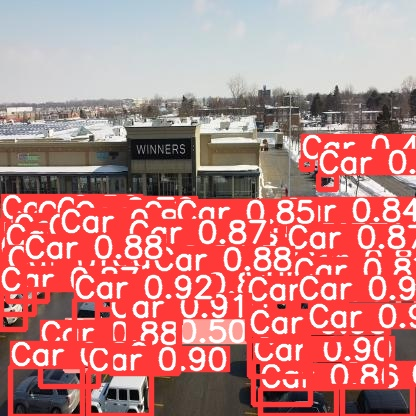

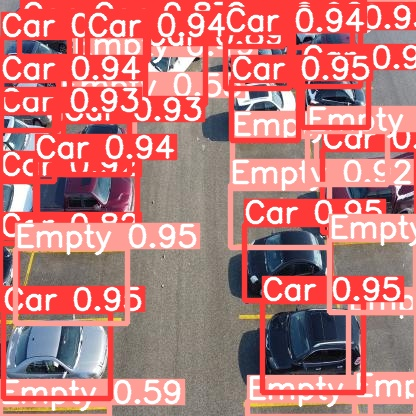

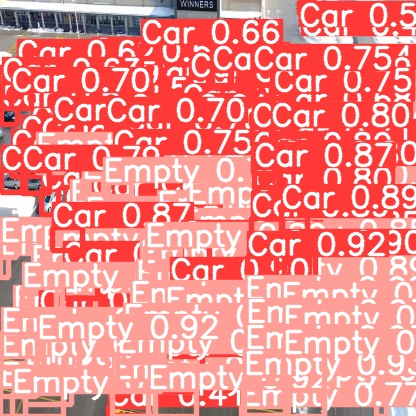

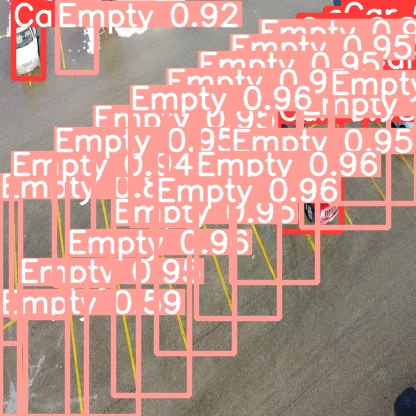

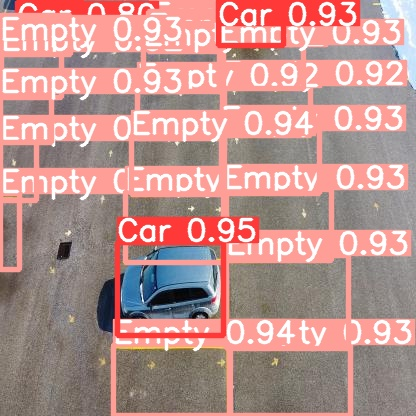

...

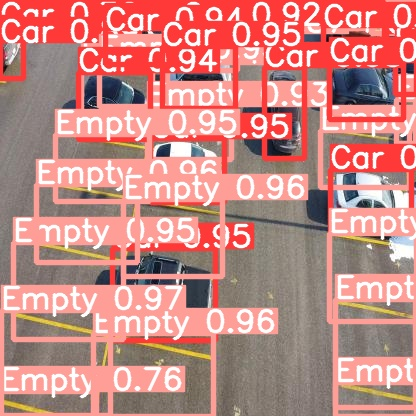

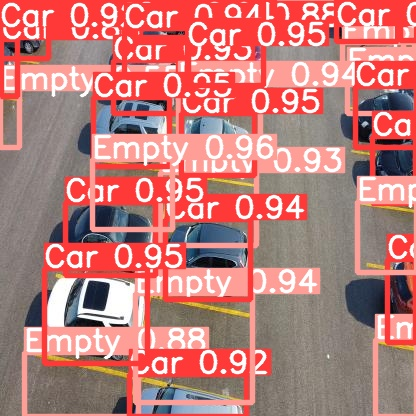

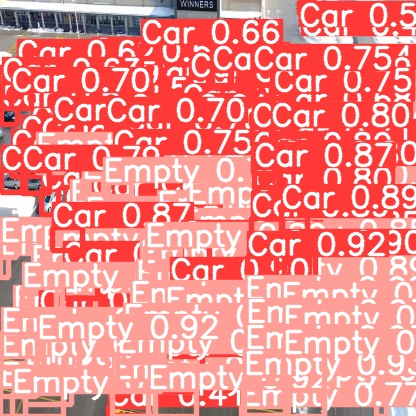

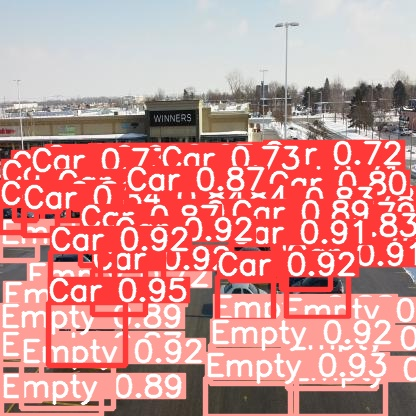

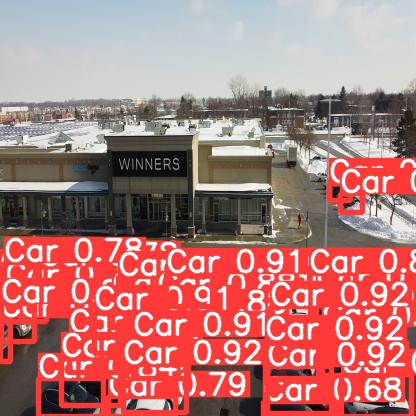

In [15]:
#display inference on ALL test images
#this looks much better with longer training above
#Running innference multiple times will create multiple exp files. Make sure that exp has correct number after it if applicable.

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Export TFLite
Now that we have the weights, we will export a tflite model.

In [16]:
!python3 export.py --weights /content/yolov5/runs/train/yolov5s_results/weights/best.pt --include tflite --img 416 --data {datasetFolder}/data.yaml

export: data=/content/yolov5/Public-Parking-Dataset/data.yaml, weights=['/content/yolov5/runs/train/yolov5s_results/weights/best.pt'], imgsz=[416], batch_size=1, device=cpu, half=False, inplace=False, train=False, keras=False, optimize=False, int8=False, dynamic=False, simplify=False, opset=12, verbose=False, workspace=4, nms=False, agnostic_nms=False, topk_per_class=100, topk_all=100, iou_thres=0.45, conf_thres=0.25, include=['tflite']
YOLOv5 🚀 v6.1-265-g8ebf569 Python-3.7.13 torch-1.12.0+cu113 CPU

Fusing layers... 
custom_YOLOv5s summary: 232 layers, 7249215 parameters, 0 gradients, 16.7 GFLOPs

PyTorch: starting from /content/yolov5/runs/train/yolov5s_results/weights/best.pt with output shape (1, 10647, 7) (14.1 MB)

TensorFlow SavedModel: starting export with tensorflow 2.8.2...

                 from  n    params  module                                  arguments                     
  0                -1  1      3520  models.common.Focus                     [3, 32, 3]           

# Test TFlite File
Run detection on all test images

In [17]:
!python detect.py --weights /content/yolov5/runs/train/yolov5s_results/weights/best-fp16.tflite --img 416 --conf 0.4 --source {datasetFolder}/test/images --data {datasetFolder}/data.yaml

detect: weights=['/content/yolov5/runs/train/yolov5s_results/weights/best-fp16.tflite'], source=/content/yolov5/Public-Parking-Dataset/test/images, data=/content/yolov5/Public-Parking-Dataset/data.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-265-g8ebf569 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Loading /content/yolov5/runs/train/yolov5s_results/weights/best-fp16.tflite for TensorFlow Lite inference...
INFO: Created TensorFlow Lite XNNPACK delegate for CPU.
image 1/34 /content/yolov5/Public-Parking-Dataset/test/images/DJI_0286_MP4-10_jpg.rf.dvrHFd9yvQdTzwTld47D.jpg: 416x416 4 Cars, 31 Emptys, Done. (0.242s)
image 2/34 /content/yolov5/Public-

View inference results. **Make sure to set the correct exp folder. Evertime the detection code above is run, a new exp folder is created**

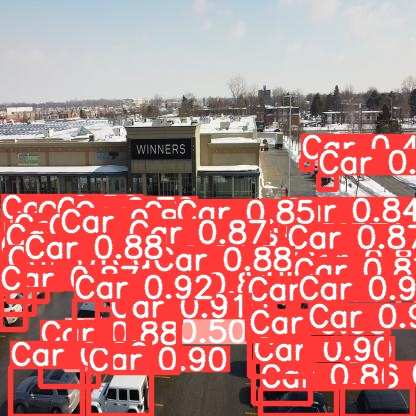

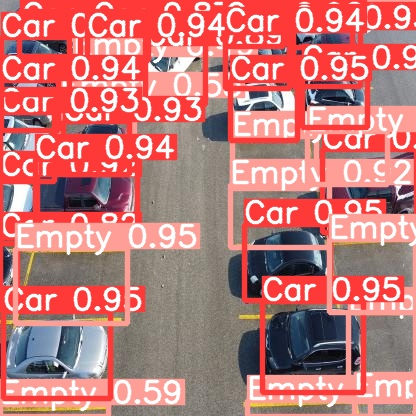

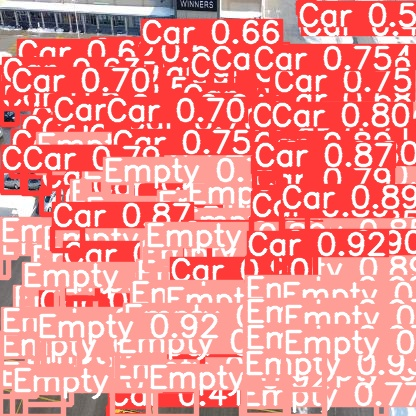

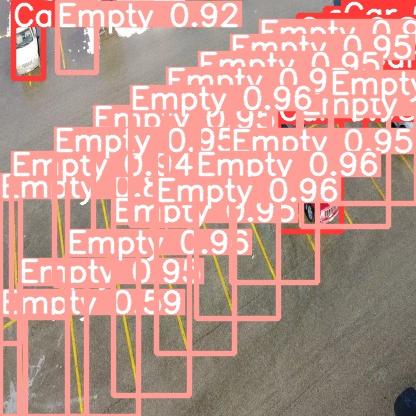

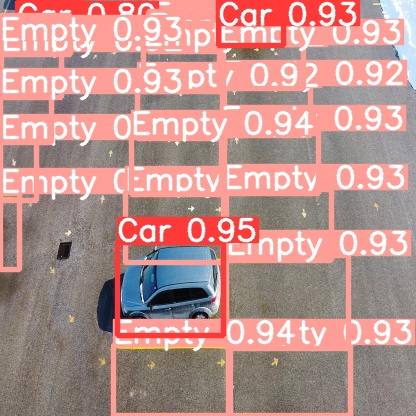

...

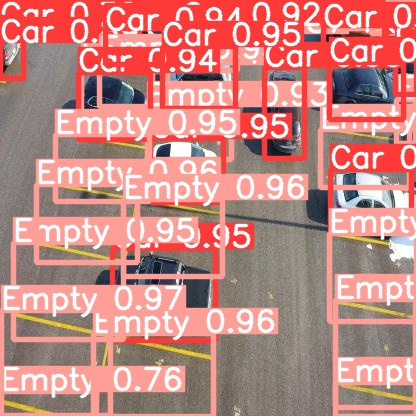

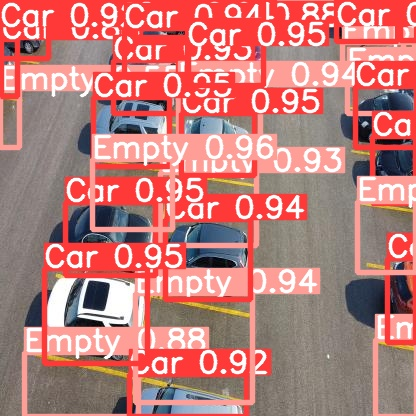

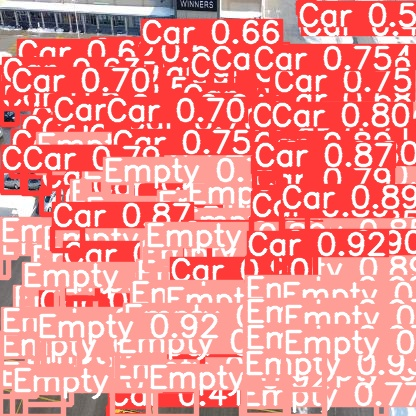

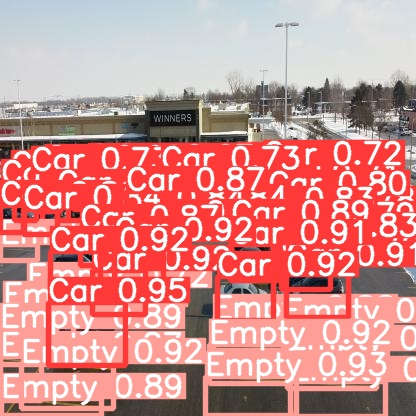

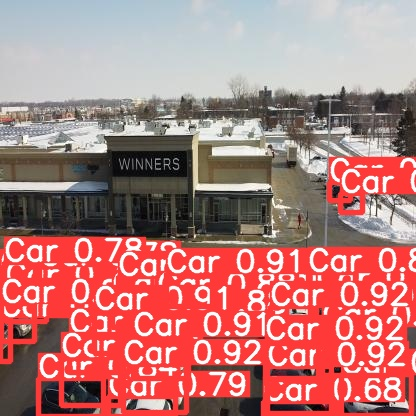

In [18]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp2/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Download TFLite
The .tflite file should be located in yolov5/runs/train/yolov5s_results/weights. Right click the file and download.